In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from scipy import stats
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import BayesianRidge
from sklearn.ensemble import RandomForestRegressor
import folium
import geopandas as gpd
import branca.colormap as cm
from shapely.geometry import Point
import pymc as pm

In [2]:
df = pd.read_csv('housing.csv')

## EDA

In [3]:
df.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra,-37.7996,144.9984,Northern Metropolitan,4019.0
1,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra,-37.8079,144.9934,Northern Metropolitan,4019.0
2,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra,-37.8093,144.9944,Northern Metropolitan,4019.0
3,Abbotsford,40 Federation La,3,h,850000.0,PI,Biggin,4/03/2017,2.5,3067.0,...,2.0,1.0,94.0,NaN,NaN,Yarra,-37.7969,144.9969,Northern Metropolitan,4019.0
4,Abbotsford,55a Park St,4,h,1600000.0,VB,Nelson,4/06/2016,2.5,3067.0,...,1.0,2.0,120.0,142.0,2014.0,Yarra,-37.8072,144.9941,Northern Metropolitan,4019.0


In [4]:
df.shape

(13580, 21)

In [5]:
df.columns

Index(['Suburb', 'Address', 'Rooms', 'Type', 'Price', 'Method', 'SellerG',
       'Date', 'Distance', 'Postcode', 'Bedroom2', 'Bathroom', 'Car',
       'Landsize', 'BuildingArea', 'YearBuilt', 'CouncilArea', 'Lattitude',
       'Longtitude', 'Regionname', 'Propertycount'],
      dtype='object')

In [6]:
df.isna().sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            0
Postcode            0
Bedroom2            0
Bathroom            0
Car                62
Landsize            0
BuildingArea     6450
YearBuilt        5375
CouncilArea      1369
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

In [7]:
df.describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,13580.000000,1.358000e+04,13580.000000,13580.000000,13580.000000,13580.000000,13518.000000,13580.000000,7130.000000,8205.000000,13580.000000,13580.000000,13580.000000
mean,2.937997,1.075684e+06,10.137776,3105.301915,2.914728,1.534242,1.610075,558.416127,151.967650,1964.684217,-37.809203,144.995216,7454.417378
std,0.955748,6.393107e+05,5.868725,90.676964,0.965921,0.691712,0.962634,3990.669241,541.014538,37.273762,0.079260,0.103916,4378.581772
min,1.000000,8.500000e+04,0.000000,3000.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1196.000000,-38.182550,144.431810,249.000000
25%,2.000000,6.500000e+05,6.100000,3044.000000,2.000000,1.000000,1.000000,177.000000,93.000000,1940.000000,-37.856822,144.929600,4380.000000
50%,3.000000,9.030000e+05,9.200000,3084.000000,3.000000,1.000000,2.000000,440.000000,126.000000,1970.000000,-37.802355,145.000100,6555.000000
75%,3.000000,1.330000e+06,13.000000,3148.000000,3.000000,2.000000,2.000000,651.000000,174.000000,1999.000000,-37.756400,145.058305,10331.000000
max,10.000000,9.000000e+06,48.100000,3977.000000,20.000000,8.000000,10.000000,433014.000000,44515.000000,2018.000000,-37.408530,145.526350,21650.000000


In [8]:
df[df['Car'].isna()].describe()

,Rooms,Price,Distance,Postcode,Bedroom2,Bathroom,Car,Landsize,BuildingArea,YearBuilt,Lattitude,Longtitude,Propertycount
count,62.000000,6.200000e+01,62.000000,62.000000,62.000000,62.000000,0.0,62.000000,29.000000,31.000000,62.000000,62.000000,62.000000
mean,2.548387,1.269226e+06,5.766129,3121.548387,2.548387,1.290323,NaN,625.032258,112.482759,1908.709677,-37.811867,144.975527,7222.080645
std,0.693705,4.710488e+05,5.833536,78.574321,0.693705,0.492138,NaN,1691.230331,26.180173,33.536243,0.051342,0.080911,3726.576935
min,1.000000,4.240000e+05,1.600000,3013.000000,1.000000,1.000000,NaN,82.000000,67.000000,1880.000000,-37.888630,144.715810,1123.000000
25%,2.000000,9.737500e+05,2.700000,3054.500000,2.000000,1.000000,NaN,141.250000,95.000000,1890.000000,-37.844005,144.947795,4856.500000
50%,3.000000,1.235000e+06,3.600000,3121.500000,3.000000,1.000000,NaN,198.500000,112.000000,1900.000000,-37.821045,144.974730,6244.000000
75%,3.000000,1.511250e+06,6.200000,3183.750000,3.000000,2.000000,NaN,337.000000,130.000000,1908.000000,-37.788152,144.995730,8648.000000
max,4.000000,2.550000e+06,31.700000,3429.000000,4.000000,3.000000,NaN,9405.000000,175.000000,2009.000000,-37.585620,145.234350,15321.000000


In [9]:
df[df['BuildingArea'].isna()]['Type'].value_counts()

Type
h    4589
u    1433
t     428
Name: count, dtype: int64

In [10]:
df[df['Car'].isna()]['Type'].value_counts()

Type
h    60
u     2
Name: count, dtype: int64

In [11]:
df[df['YearBuilt'].isna()]['Date'].value_counts()

Date
27/05/2017    197
12/08/2017    190
24/06/2017    181
17/06/2017    171
18/03/2017    159
3/06/2017     157
4/03/2017     145
20/05/2017    145
29/07/2017    144
1/07/2017     141
27/11/2016    136
25/02/2017    123
10/12/2016    123
16/09/2017    119
13/05/2017    118
22/07/2017    116
23/09/2017    116
15/07/2017    111
8/07/2017     109
3/09/2017     108
15/10/2016    104
8/04/2017     103
3/12/2016     103
9/09/2017      99
12/11/2016     98
18/06/2016     98
28/05/2016     97
29/04/2017     93
8/10/2016      92
28/08/2016     88
26/08/2017     87
17/09/2016     87
24/09/2016     84
19/11/2016     83
19/08/2017     81
14/05/2016     81
22/05/2016     74
7/05/2016      74
10/09/2016     71
27/06/2016     70
30/07/2016     69
22/08/2016     68
3/09/2016      65
6/05/2017      64
16/04/2016     63
7/11/2016      62
4/06/2016      57
16/07/2016     54
22/04/2017     54
13/08/2016     51
23/04/2016     42
6/08/2016      41
26/07/2016     36
11/02/2017     28
11/03/2017     22
12/06

In [12]:
df['YearBuilt'].value_counts()

YearBuilt
1970.0    866
1960.0    725
1950.0    580
1900.0    341
1980.0    338
         ... 
1897.0      1
1933.0      1
1830.0      1
1901.0      1
1857.0      1
Name: count, Length: 144, dtype: int64

In [13]:
type(df['YearBuilt'].iloc[0])

numpy.float64

In [14]:
min_year_built = df['YearBuilt'].min()
max_year_built = df['YearBuilt'].max()

min_year_built, max_year_built

(1196.0, 2018.0)

In [15]:

df['Date'] = pd.to_datetime(df['Date'], format='%d/%m/%Y')
min_date = df['Date'].min()
min_date

Timestamp('2016-01-28 00:00:00')

In [16]:
df['YearBuilt'].value_counts()

YearBuilt
1970.0    866
1960.0    725
1950.0    580
1900.0    341
1980.0    338
         ... 
1897.0      1
1933.0      1
1830.0      1
1901.0      1
1857.0      1
Name: count, Length: 144, dtype: int64

In [17]:
df['Method'].value_counts()

Method
S     9022
SP    1703
PI    1564
VB    1199
SA      92
Name: count, dtype: int64

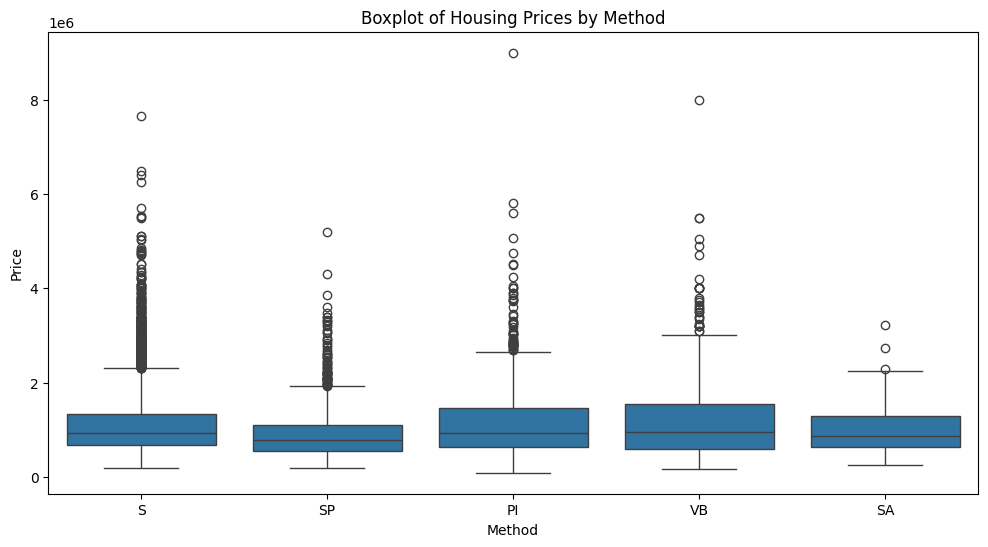

In [18]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='Method', y='Price', data=df)
plt.title('Boxplot of Housing Prices by Method')
plt.xlabel('Method')
plt.ylabel('Price')
plt.show()

In [19]:
df[df['Price'] == 9000000]

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
12094,Mulgrave,35 Bevis St,3,h,9000000.0,PI,Hall,2017-07-29,18.8,3170.0,...,1.0,1.0,744.0,117.0,1960.0,Monash,-37.93168,145.16126,South-Eastern Metropolitan,7113.0


In [20]:
df_sorted_by_year_built = df.sort_values(by='YearBuilt', ascending=True)
df_sorted_by_year_built.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
9968,Mount Waverley,5 Armstrong St,3,h,1200000.0,VB,McGrath,2017-06-24,14.2,3149.0,...,1.0,4.0,807.0,117.0,1196.0,Monash,-37.86788,145.12121,Eastern Metropolitan,13366.0
2079,Collingwood,2/79 Oxford St,2,u,855000.0,S,Nelson,2016-09-03,1.6,3066.0,...,1.0,1.0,2886.0,122.0,1830.0,Yarra,-37.80420,144.98450,Northern Metropolitan,4553.0
5860,St Kilda,51/167 Fitzroy St,3,u,1600000.0,PI,Kay,2017-02-25,6.1,3182.0,...,2.0,2.0,0.0,3.0,1850.0,Port Phillip,-37.85840,144.98020,Southern Metropolitan,13240.0
4843,Prahran,602/220 Commercial Rd,2,u,841000.0,S,hockingstuart,2017-03-18,4.5,3181.0,...,2.0,1.0,0.0,101.0,1850.0,Stonnington,-37.84700,144.99360,Southern Metropolitan,7717.0
2554,Fitzroy,11 Henry St,2,h,677000.0,S,Chambers,2016-11-27,1.6,3065.0,...,1.0,0.0,67.0,NaN,1850.0,Yarra,-37.79690,144.97590,Northern Metropolitan,5825.0


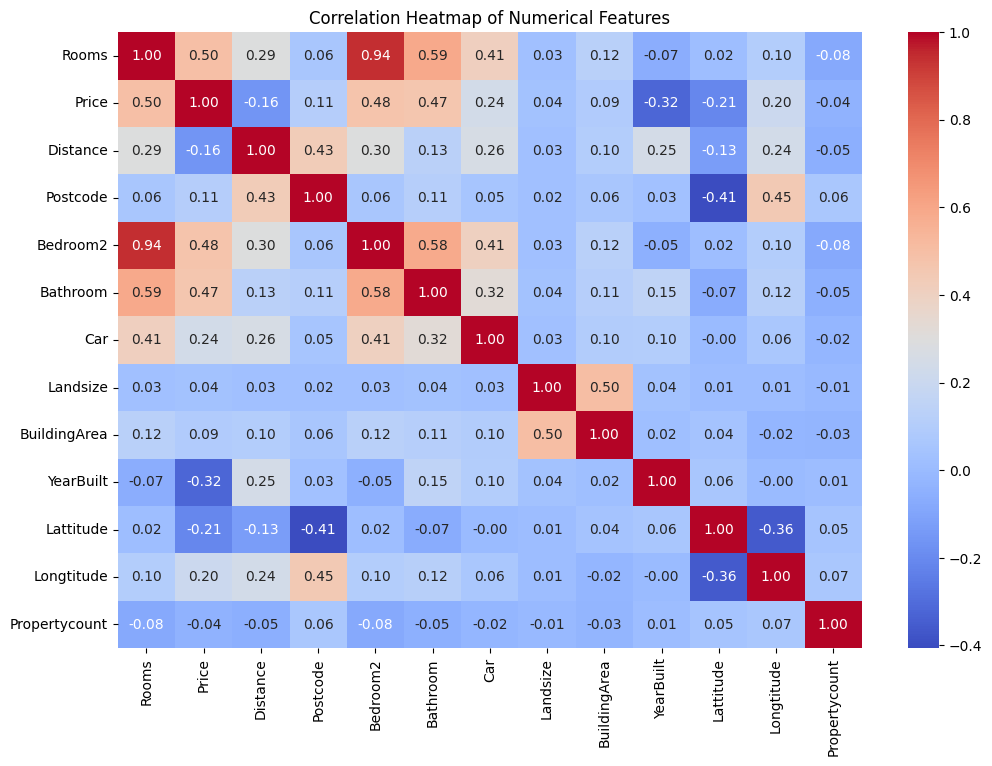

In [21]:
numeric_df = df.select_dtypes(include=[np.number])
corr_matrix = numeric_df.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap of Numerical Features')
plt.show()

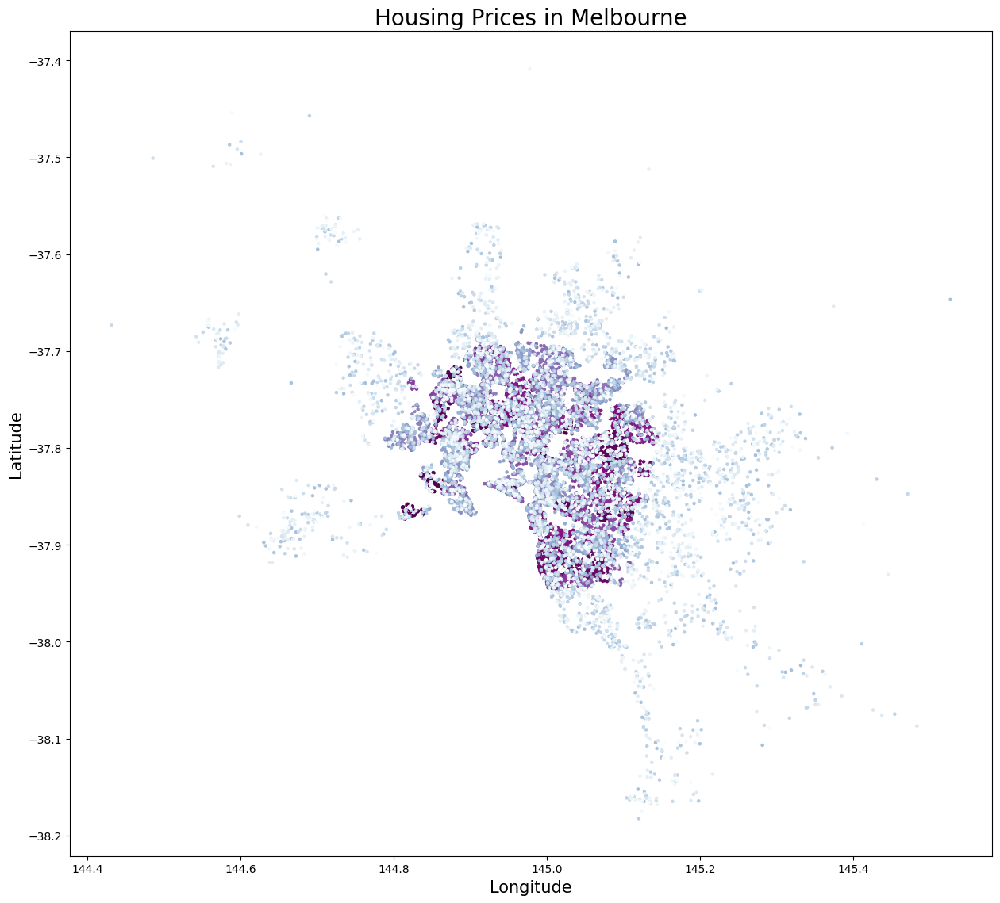

In [22]:
geometry = [Point(xy) for xy in zip(df['Longtitude'], df['Lattitude'])]
geo_df = gpd.GeoDataFrame(df, crs="EPSG:4326", geometry=geometry)

fig, ax = plt.subplots(figsize=(15,15))
geo_df.plot(ax=ax, marker='o', c=geo_df['Price'], cmap='BuPu_r', markersize=5)

ax.set_title('Housing Prices in Melbourne', fontsize=20)
ax.set_xlabel('Longitude', fontsize=15)
ax.set_ylabel('Latitude', fontsize=15)

plt.show()

In [23]:
colormap = cm.linear.YlGnBu_09.scale(df['Price'].min(), df['Price'].max())

m = folium.Map(location=[-37.809203, 144.975527], zoom_start=10)

for idx, row in geo_df.iterrows():
    folium.CircleMarker(
        location=[row['Lattitude'], row['Longtitude']],
        radius=5,
        popup=f"Price: {row['Price']}",
        color=colormap(row['Price']),
        fill=True,
        fill_color=colormap(row['Price'])
    ).add_to(m)

colormap.add_to(m)
m

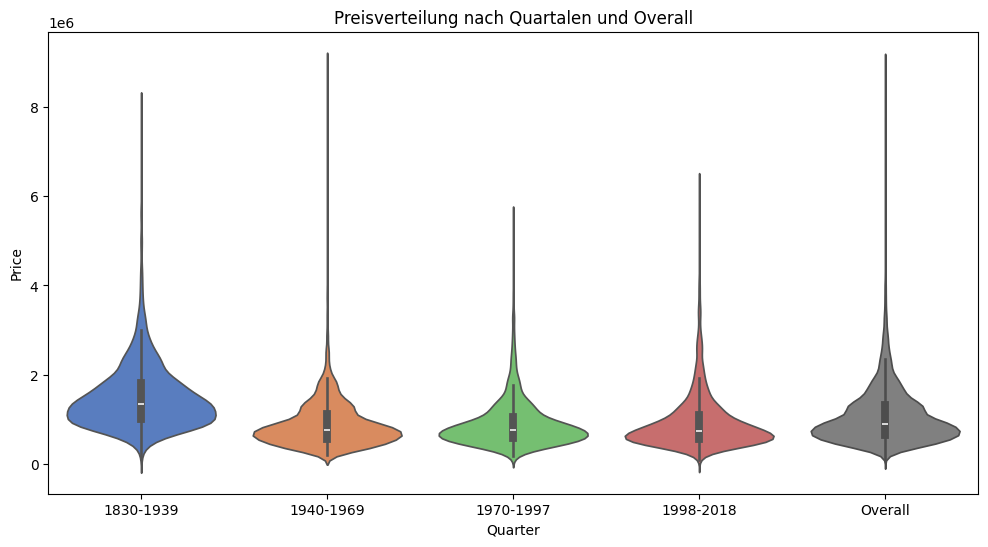

In [24]:
df['Quarter'] = pd.cut(df['YearBuilt'], bins=[1830, 1940, 1970, 1998, 2018], labels=['1830-1939', '1940-1969', '1970-1997', '1998-2018'])

df['Overall'] = 'Overall'

plt.figure(figsize=(12, 6))
sns.violinplot(x='Quarter', y='Price', data=df, inner='box', palette='muted', hue='Quarter', legend=False)
sns.violinplot(x='Overall', y='Price', data=df, inner='box', palette=['gray'], hue='Overall', legend=False)

plt.xlabel('Quarter')
plt.ylabel('Price')
plt.title('Preisverteilung nach Quartalen und Overall')

plt.show()

In [25]:
l = df[df['Price']<4000000]

/var/folders/b0/h1xx55fn0m7f9j3k4jxny4nm0000gn/T/ipykernel_3679/3127044337.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  l['Quarter'] = pd.cut(l['YearBuilt'], bins=[1830, 1940, 1970, 1998, 2018], labels=['1830-1939', '1940-1969', '1970-1997', '1998-2018'])
/var/folders/b0/h1xx55fn0m7f9j3k4jxny4nm0000gn/T/ipykernel_3679/3127044337.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  l['Overall'] = 'Overall'


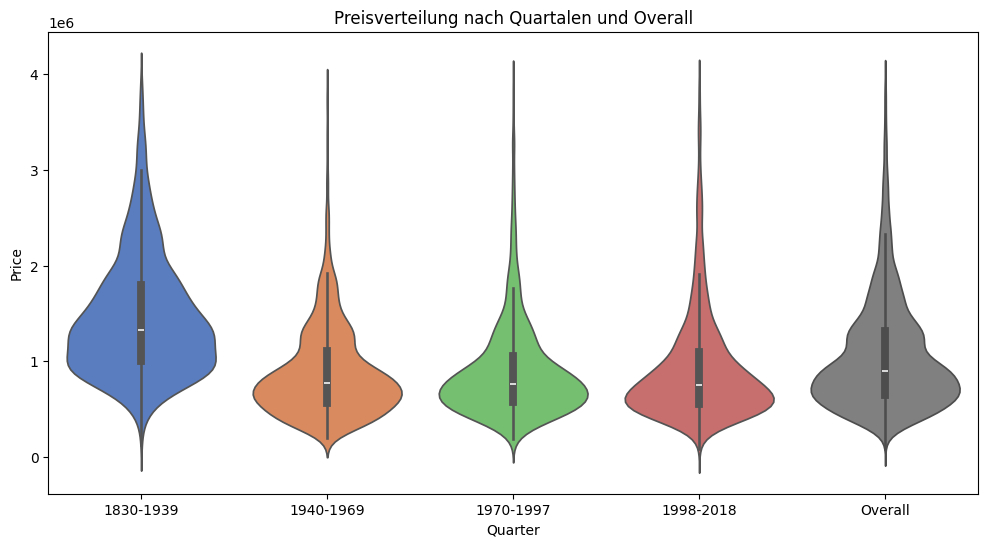

In [26]:
l['Quarter'] = pd.cut(l['YearBuilt'], bins=[1830, 1940, 1970, 1998, 2018], labels=['1830-1939', '1940-1969', '1970-1997', '1998-2018'])

l['Overall'] = 'Overall'

plt.figure(figsize=(12, 6))
sns.violinplot(x='Quarter', y='Price', data=l, inner='box', palette='muted', hue='Quarter', legend=False)
sns.violinplot(x='Overall', y='Price', data=l, inner='box', palette=['gray'], hue='Overall', legend=False)

plt.xlabel('Quarter')
plt.ylabel('Price')
plt.title('Preisverteilung nach Quartalen und Overall')

plt.show()

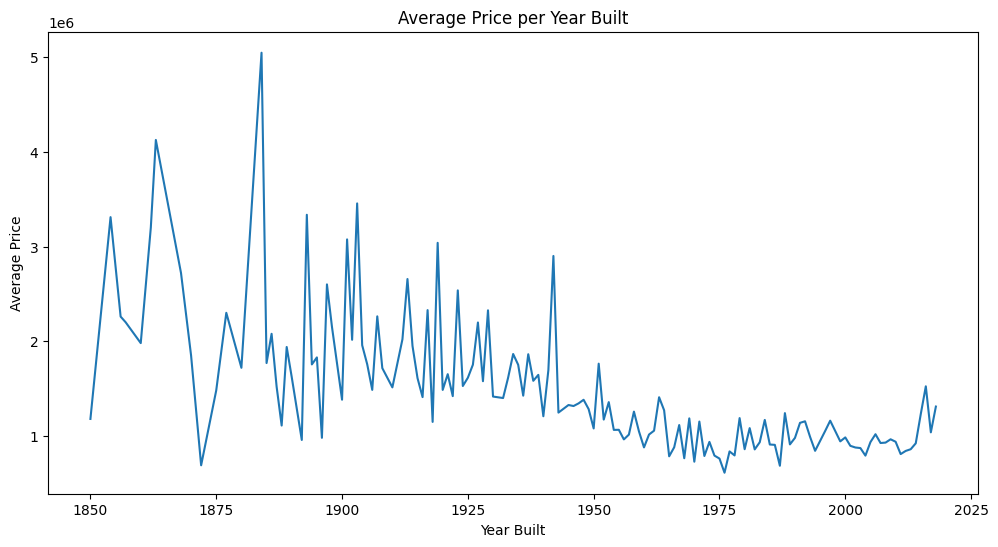

In [27]:
average_price_per_year = df.groupby('YearBuilt')['Price'].mean().reset_index()

plt.figure(figsize=(12, 6))
sns.lineplot(data=average_price_per_year[average_price_per_year['YearBuilt'] >= 1850], x='YearBuilt', y='Price')
plt.xlabel('Year Built')
plt.ylabel('Average Price')
plt.title('Average Price per Year Built')
plt.show()

Mean Squared Error (MSE) between LOWESS and cubic: 32058108778.2962
R² between LOWESS and cubic: 0.8079645609500925


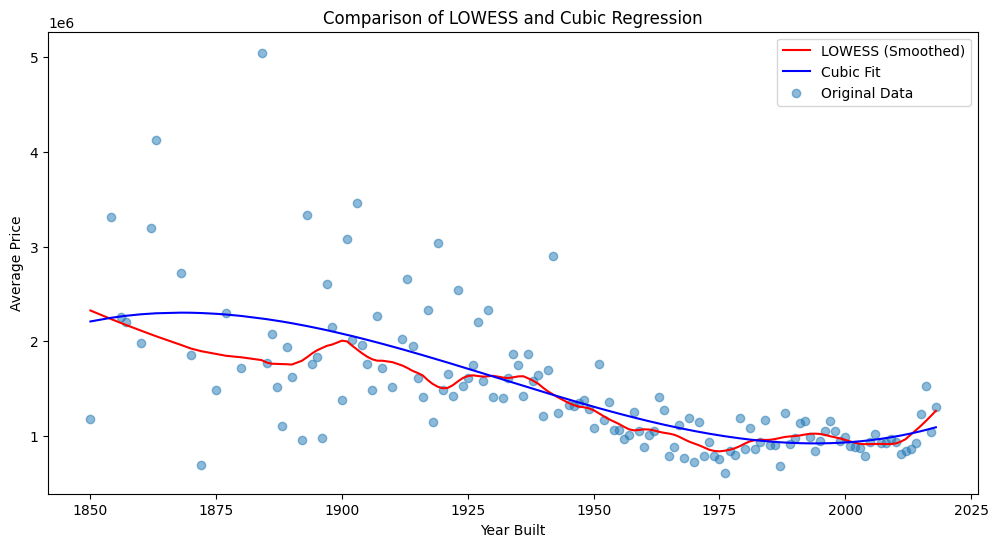

In [28]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
import statsmodels.api as sm


filtered_data = average_price_per_year[average_price_per_year['YearBuilt'] >= 1850].reset_index(drop=True)

lowess = sm.nonparametric.lowess(filtered_data['Price'], filtered_data['YearBuilt'], frac=0.1)

X = filtered_data['YearBuilt'].values.reshape(-1, 1)
y = filtered_data['Price']

poly = PolynomialFeatures(degree=3)
X_cubic = poly.fit_transform(X)

model = LinearRegression()
model.fit(X_cubic, y)

y_cubic = model.predict(X_cubic)

lowess_prices = np.interp(X.flatten(), lowess[:, 0], lowess[:, 1])  
mse = mean_squared_error(lowess_prices, y_cubic)
r2 = r2_score(lowess_prices, y_cubic)

print(f"Mean Squared Error (MSE) between LOWESS and cubic: {mse}")
print(f"R² between LOWESS and cubic: {r2}")

plt.figure(figsize=(12, 6))
plt.plot(filtered_data['YearBuilt'], lowess_prices, label='LOWESS (Smoothed)', color='red')
plt.plot(filtered_data['YearBuilt'], y_cubic, label='Cubic Fit', color='blue')
plt.scatter(filtered_data['YearBuilt'], filtered_data['Price'], alpha=0.5, label='Original Data')
plt.xlabel('Year Built')
plt.ylabel('Average Price')
plt.title('Comparison of LOWESS and Cubic Regression')
plt.legend()
plt.show()

In [29]:
average_values = df.groupby('Quarter')[['Rooms', 'Distance', 'Car', 'Landsize', 'BuildingArea']].mean()

print(average_values)

              Rooms   Distance       Car    Landsize  BuildingArea
Quarter                                                           
1830-1939  3.095969   6.868906  1.400389  434.269194    151.816346
1940-1969  2.802404  10.950902  1.635714  500.700977    125.649922
1970-1997  3.039503  12.973372  1.758974  494.432334    147.262461
1998-2018  2.875598  10.007273  1.609861  543.456938    153.974588


/var/folders/b0/h1xx55fn0m7f9j3k4jxny4nm0000gn/T/ipykernel_3679/1157949516.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  average_values = df.groupby('Quarter')[['Rooms', 'Distance', 'Car', 'Landsize', 'BuildingArea']].mean()


In [30]:
df['YearBuilt'].mean()

1964.6842169408897

In [31]:
average_price_per_year = average_price_per_year[average_price_per_year['YearBuilt'] != 1196.0]
print(average_price_per_year.sort_values(by='Price', ascending=True))

     YearBuilt         Price
101     1976.0  6.114545e+05
112     1987.0  6.852500e+05
11      1872.0  6.900000e+05
95      1970.0  7.279436e+05
100     1975.0  7.608938e+05
..         ...           ...
3       1854.0  3.310000e+06
23      1893.0  3.335000e+06
32      1903.0  3.455000e+06
8       1863.0  4.125000e+06
15      1884.0  5.046000e+06

[143 rows x 2 columns]


In [32]:
import numpy as np

df['price'] = np.log(df['Price'])
print(df[['Price', 'price']].head())

       Price      price
0  1480000.0  14.207553
1  1035000.0  13.849912
2  1465000.0  14.197366
3   850000.0  13.652992
4  1600000.0  14.285514


<Figure size 640x480 with 0 Axes>

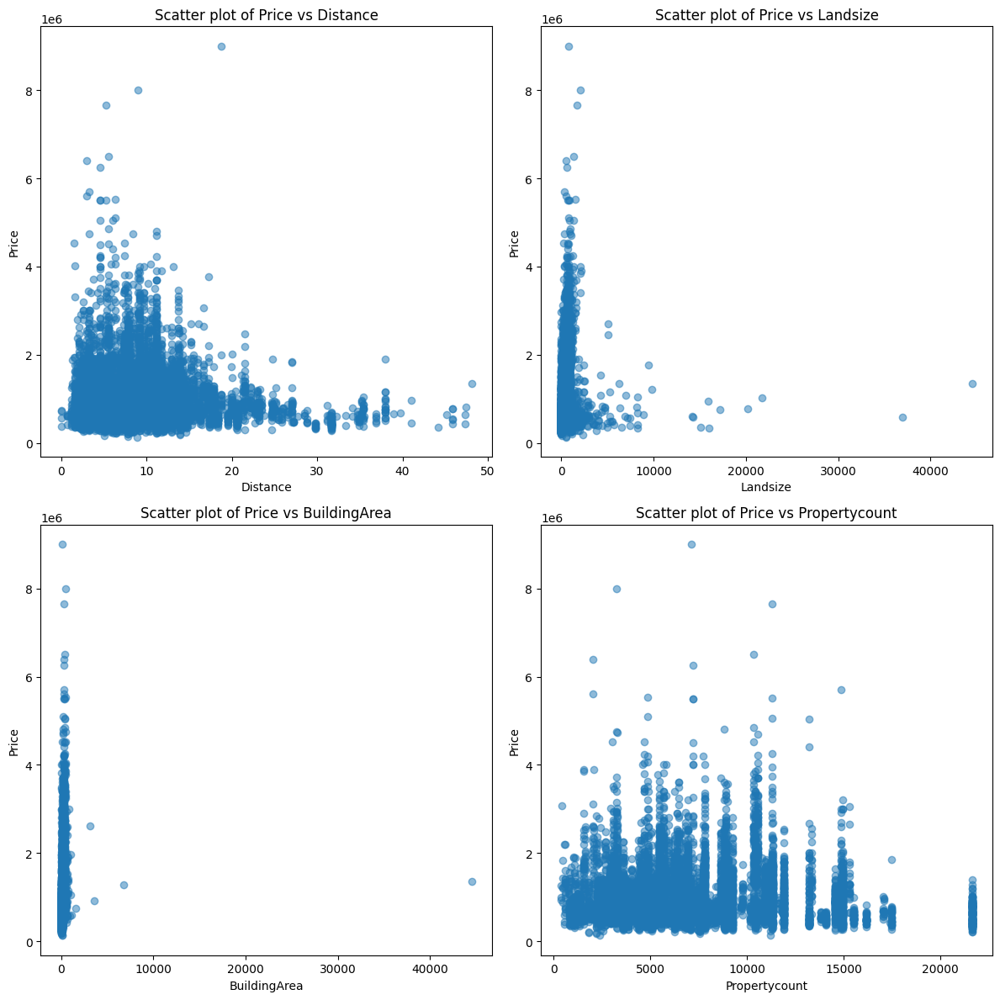

In [33]:
plt.tight_layout()
filtered_df = df[(df['Landsize'] < 400000) & (df['BuildingArea'] < 400000)]

plt.figure(figsize=(12, 12))

features = ['Distance', 'Landsize', 'BuildingArea', 'Propertycount']
for i, feature in enumerate(features, 1):
    plt.subplot(2, 2, i)
    plt.scatter(filtered_df[feature], filtered_df['Price'], alpha=0.5)
    plt.title(f'Scatter plot of Price vs {feature}')
    plt.xlabel(feature)
    plt.ylabel('Price')

plt.tight_layout()
plt.show()

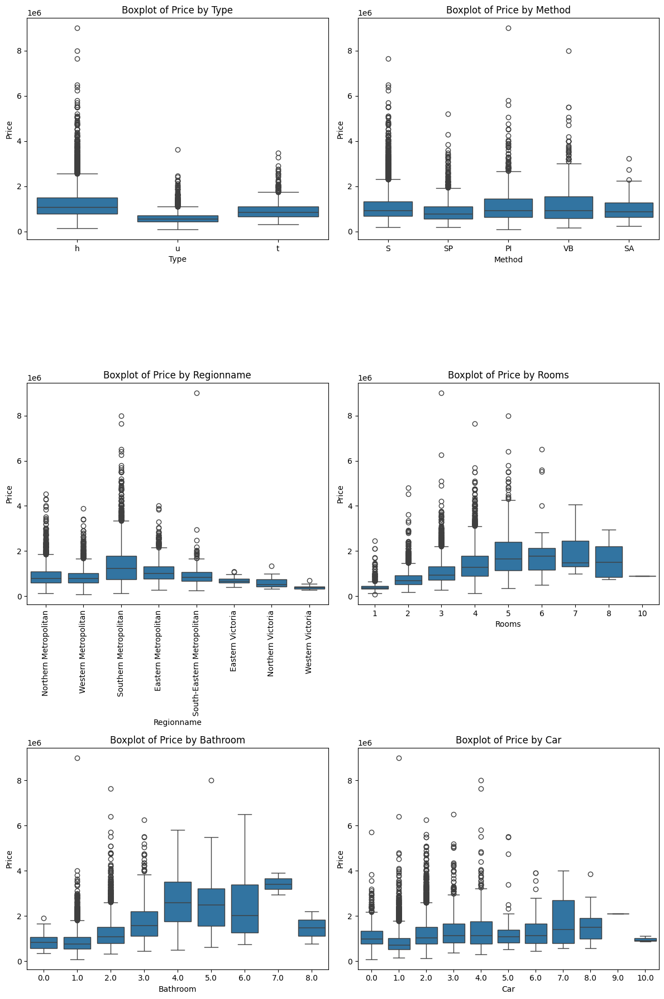

In [34]:
plt.figure(figsize=(12,18))

plt.subplot(3, 2, 1)
sns.boxplot(x='Type', y='Price', data=df)
plt.title('Boxplot of Price by Type')

plt.subplot(3, 2, 2)
sns.boxplot(x='Method', y='Price', data=df)
plt.title('Boxplot of Price by Method')

plt.subplot(3, 2, 3)
sns.boxplot(x='Regionname', y='Price', data=df)
plt.title('Boxplot of Price by Regionname')
plt.xticks(rotation=90)

plt.subplot(3, 2, 4)
sns.boxplot(x='Rooms', y='Price', data=df)
plt.title('Boxplot of Price by Rooms')

plt.subplot(3, 2, 5)
sns.boxplot(x='Bathroom', y='Price', data=df)
plt.title('Boxplot of Price by Bathroom')

plt.subplot(3, 2, 6)
sns.boxplot(x='Car', y='Price', data=df)
plt.title('Boxplot of Price by Car')

plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Boxplot of Price by Rooms')

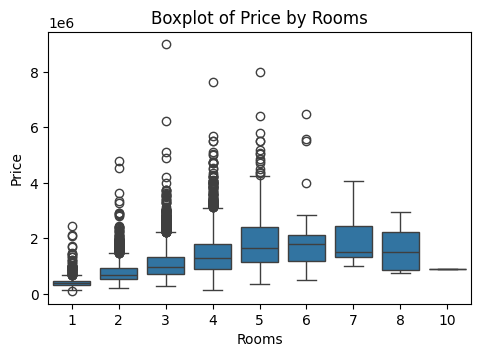

In [35]:
plt.figure(figsize=(12,12))
plt.subplot(3, 2, 4)
sns.boxplot(x='Rooms', y='Price', data=df)
plt.title('Boxplot of Price by Rooms')

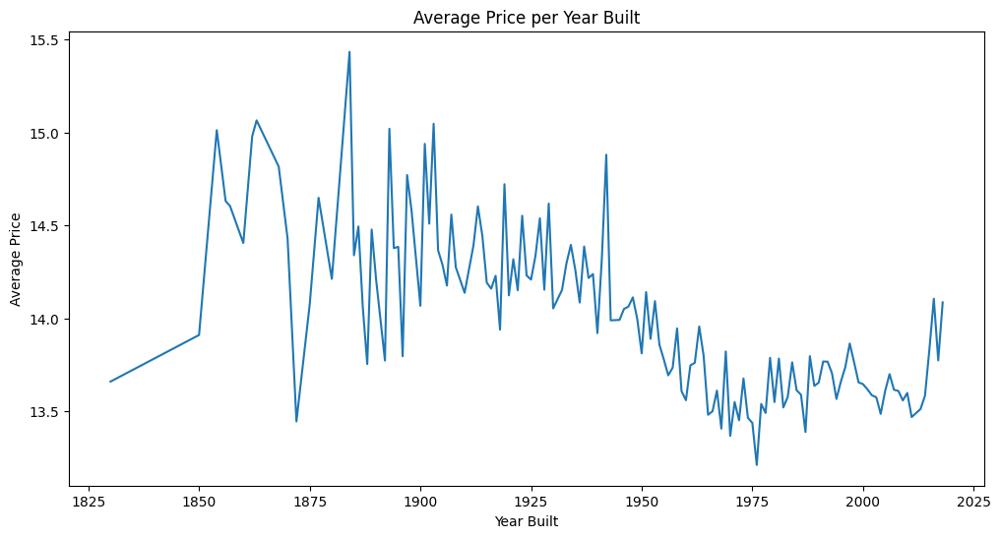

In [36]:
average_price_per_year = df.groupby('YearBuilt')['price'].mean().reset_index()

plt.figure(figsize=(12, 6))
sns.lineplot(data=average_price_per_year[average_price_per_year['YearBuilt'] >= 1830], x='YearBuilt', y='price')
plt.xlabel('Year Built')
plt.ylabel('Average Price')
plt.title('Average Price per Year Built')
plt.show()

Mean Squared Error (MSE) between LOWESS and cubic: 0.012010989476642711
R² between LOWESS and cubic: 0.9042938641619446


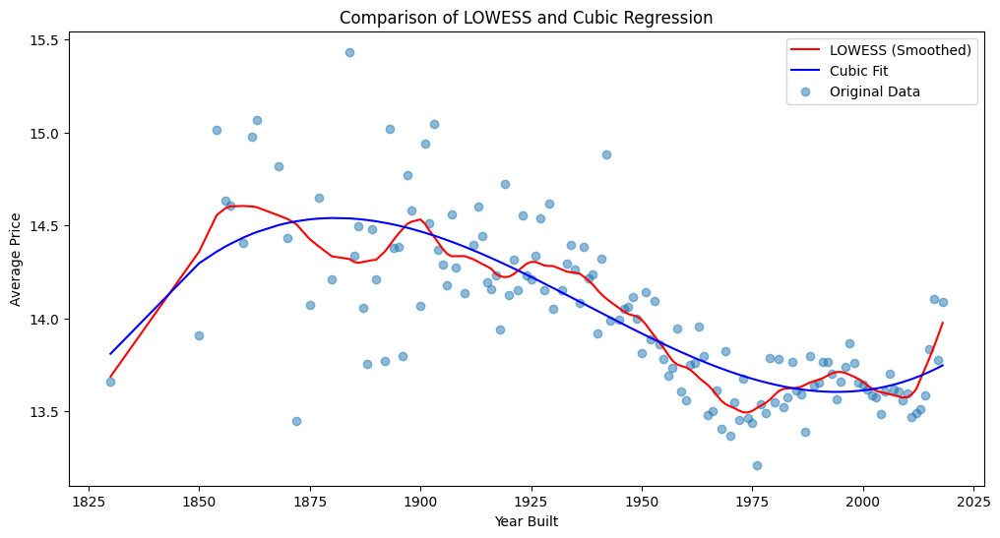

In [37]:
filtered_data = average_price_per_year[average_price_per_year['YearBuilt'] >= 1830].reset_index(drop=True)

lowess = sm.nonparametric.lowess(filtered_data['price'], filtered_data['YearBuilt'], frac=0.1)

X = filtered_data['YearBuilt'].values.reshape(-1, 1)
y = filtered_data['price']

poly = PolynomialFeatures(degree=3)
X_cubic = poly.fit_transform(X)

model = LinearRegression()
model.fit(X_cubic, y)

y_cubic = model.predict(X_cubic)

lowess_prices = np.interp(X.flatten(), lowess[:, 0], lowess[:, 1])  
mse = mean_squared_error(lowess_prices, y_cubic)
r2 = r2_score(lowess_prices, y_cubic)

print(f"Mean Squared Error (MSE) between LOWESS and cubic: {mse}")
print(f"R² between LOWESS and cubic: {r2}")

plt.figure(figsize=(12, 6))
plt.plot(filtered_data['YearBuilt'], lowess_prices, label='LOWESS (Smoothed)', color='red')
plt.plot(filtered_data['YearBuilt'], y_cubic, label='Cubic Fit', color='blue')
plt.scatter(filtered_data['YearBuilt'], filtered_data['price'], alpha=0.5, label='Original Data')
plt.xlabel('Year Built')
plt.ylabel('Average Price')
plt.title('Comparison of LOWESS and Cubic Regression')
plt.legend()
plt.show()

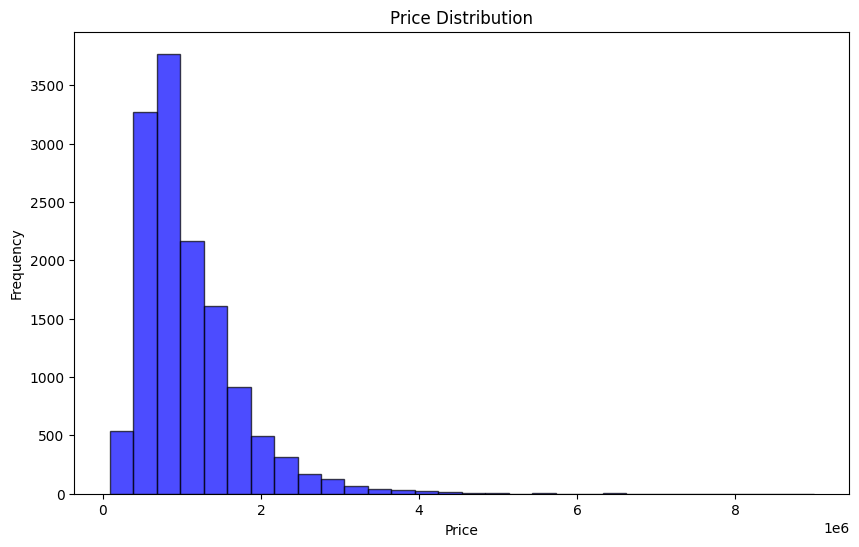

In [38]:
plt.figure(figsize=(10, 6))
plt.hist(df['Price'], bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Price Distribution')
plt.show()

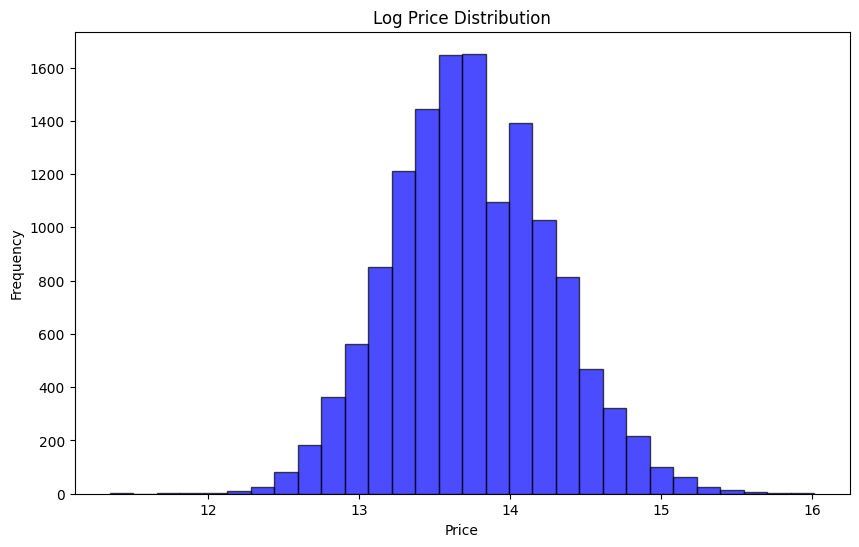

In [39]:
plt.figure(figsize=(10, 6))
plt.hist(df['price'], bins=30, color='blue', edgecolor='black', alpha=0.7)
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Log Price Distribution')
plt.show()

## Cleaning

In [40]:
df = pd.read_csv('housing.csv')

In [41]:
df.isna().sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            0
Postcode            0
Bedroom2            0
Bathroom            0
Car                62
Landsize            0
BuildingArea     6450
YearBuilt        5375
CouncilArea      1369
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

In [42]:
(df == 0).sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            6
Postcode            0
Bedroom2           16
Bathroom           34
Car              1026
Landsize         1939
BuildingArea       17
YearBuilt           0
CouncilArea         0
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

<h2> Mode Imputation for the Council Area<h2>

In [43]:
postcode_mode = df.groupby('Postcode')['CouncilArea'].agg(lambda x: x.mode().iloc[0] if not x.mode().empty else pd.NA)

def impute_council_area(row):
    if pd.isna(row['CouncilArea']):
        return postcode_mode.get(row['Postcode'], row['CouncilArea'])
    return row['CouncilArea']

df['CouncilArea'] = df.apply(impute_council_area, axis=1)
df['CouncilArea'].isna().sum()

3

We have 3 missing values left, since the postcodes were not assigned a council area in the dataset. In order to impute these we take the most common value, without taking the postcodes into account.

In [44]:
global_mode = df['CouncilArea'].mode().iloc[0]
df['CouncilArea'] = df['CouncilArea'].fillna(global_mode)

print("NaNs in Council Area after Imputation:", df['CouncilArea'].isna().sum())


NaNs in Council Area after Imputation: 0


<h2>Iterative Imputer for Bathroom, Bedroom, Landsize, and BuildingArea <h2>

In [45]:
df['Bathroom'] = df['Bathroom'].replace(0, np.nan)
df['Bedroom2'] = df['Bedroom2'].replace(0, np.nan)
df['Landsize'] = df['Landsize'].replace(0, np.nan)
df['BuildingArea'] = df['BuildingArea'].replace(0, np.nan)

print("Number of NaNs in Landsize:", df['Landsize'].isna().sum())

Number of NaNs in Landsize: 1939


In [46]:
df_imputed = df.copy()
columns_for_imputation = ['Bedroom2', 'Bathroom', 'Landsize', 'BuildingArea']

In [47]:
imputer = IterativeImputer(estimator=RandomForestRegressor(n_estimators=20, random_state=42), max_iter=100, tol=1e-2, random_state=42)
imputed_data = imputer.fit_transform(df_imputed[columns_for_imputation])

df_imputed[columns_for_imputation] = imputed_data

In [48]:
print('Mean:', df_imputed['Landsize'].mean(),'Standard Deviation:', df_imputed['Landsize'].std(),'Median:', df_imputed['Landsize'].median(),'Min:',  df_imputed['Landsize'].min(),'Max:', df_imputed['Landsize'].max())
print('Mean:', df['Landsize'].mean(),'Standard Deviation:', df['Landsize'].std(),'Median:', df['Landsize'].median(),'Min:', df['Landsize'].min(),'Max:', df['Landsize'].max())

Mean: 671.9018522863798 Standard Deviation: 4004.588040198594 Median: 533.0 Min: 1.0 Max: 433014.0
Mean: 651.4295163645735 Standard Deviation: 4303.221597742779 Median: 533.0 Min: 1.0 Max: 433014.0


In [49]:
print('Mean:', df_imputed['BuildingArea'].mean(),'Standard Deviation:', df_imputed['BuildingArea'].std(),'Median:', df_imputed['BuildingArea'].median(),'Min:',  df_imputed['BuildingArea'].min(),'Max:', df_imputed['BuildingArea'].max())
print('Mean:', df['BuildingArea'].mean(),'Standard Deviation:', df['BuildingArea'].std(),'Median:', df['BuildingArea'].median(),'Min:', df['BuildingArea'].min(),'Max:', df['BuildingArea'].max())

Mean: 153.5657285903674 Standard Deviation: 551.7760702848593 Median: 125.79583333333332 Min: 1.0 Max: 44515.0
Mean: 152.3308510754956 Standard Deviation: 541.6096713155692 Median: 126.0 Min: 1.0 Max: 44515.0


In [50]:
df = df_imputed
df.isna().sum()

Suburb              0
Address             0
Rooms               0
Type                0
Price               0
Method              0
SellerG             0
Date                0
Distance            0
Postcode            0
Bedroom2            0
Bathroom            0
Car                62
Landsize            0
BuildingArea        0
YearBuilt        5375
CouncilArea         0
Lattitude           0
Longtitude          0
Regionname          0
Propertycount       0
dtype: int64

<h2>Clustering + Bayesian Imputation for Year Built<h2>

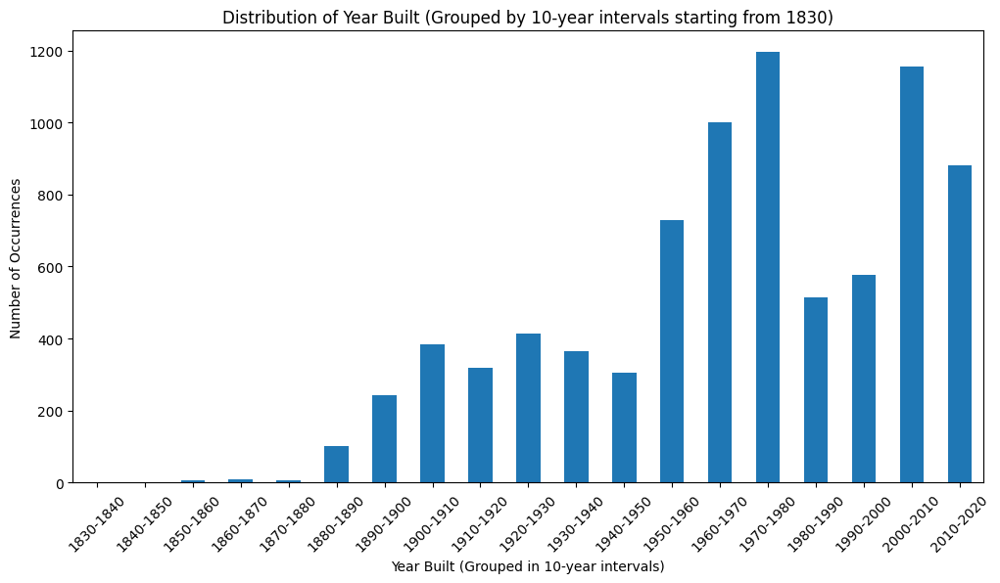

In [51]:
bins = range(1830, int(df['YearBuilt'].max()) + 10, 10)  
labels = [f"{i}-{i+10}" for i in bins[:-1]]  

df['YearBuiltGrouped'] = pd.cut(df['YearBuilt'], bins=bins, labels=labels, right=False)

df['YearBuiltGrouped'].value_counts().sort_index().plot(kind='bar', figsize=(12, 6))

plt.xlabel('Year Built (Grouped in 10-year intervals)')
plt.ylabel('Number of Occurrences')
plt.title('Distribution of Year Built (Grouped by 10-year intervals starting from 1830)')
plt.xticks(rotation=45)
plt.show()

In [52]:
# k means Clustering
clustering_features = ['Rooms', 'Price', 'Landsize', 'BuildingArea', 'Distance']

scaler = StandardScaler()
imputer = SimpleImputer(strategy='median')

X = df[clustering_features].copy()
X = imputer.fit_transform(X)
X = scaler.fit_transform(X)

n_clusters = 10
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
df['Cluster'] = kmeans.fit_predict(X)

# Bayesian Imputation

def improved_bayesian_impute(group):
    known_years = group['YearBuilt'].dropna()
    if len(known_years) < 2:
        return group
    
    # Kernel Density Estimation for Prior
    from scipy.stats import gaussian_kde
    kde = gaussian_kde(known_years)
    
    # Likelihood estimation
    features = ['Rooms', 'Price', 'BuildingArea', 'Distance']
    missing_mask = group['YearBuilt'].isna()
    
    for idx in group[missing_mask].index:
        similar_houses = group[~missing_mask].copy()
        
        weights = np.ones(len(similar_houses))
        for feature in features:
            if feature in group.columns:
                diff = abs(group.loc[idx, feature] - similar_houses[feature])
                weights *= np.exp(-diff / diff.std())
        
        weights /= weights.sum()
        
        # Posterior based on KDE and Likelihood
        posterior_sample = np.random.choice(
            similar_houses['YearBuilt'],
            size=1,
            p=weights
        )[0]
        
        group.loc[idx, 'YearBuilt'] = posterior_sample
    
    return group

df = df.groupby('Cluster').apply(improved_bayesian_impute)

/var/folders/b0/h1xx55fn0m7f9j3k4jxny4nm0000gn/T/ipykernel_3679/2859641383.py:52: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df = df.groupby('Cluster').apply(improved_bayesian_impute)


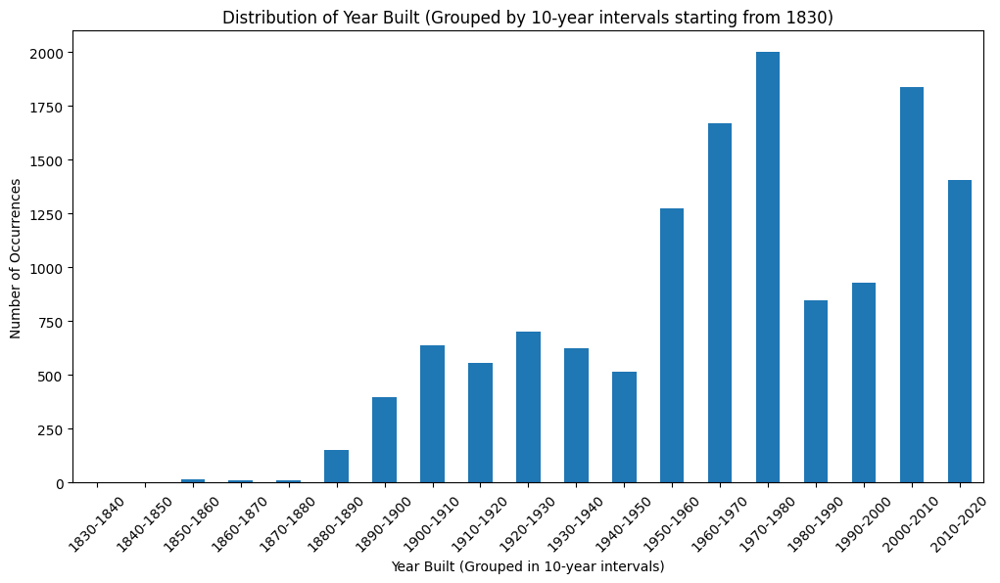

In [53]:
bins = range(1830, int(df['YearBuilt'].max()) + 10, 10)  
labels = [f"{i}-{i+10}" for i in bins[:-1]]  

df['YearBuiltGrouped'] = pd.cut(df['YearBuilt'], bins=bins, labels=labels, right=False)

df['YearBuiltGrouped'].value_counts().sort_index().plot(kind='bar', figsize=(12, 6))

plt.xlabel('Year Built (Grouped in 10-year intervals)')
plt.ylabel('Number of Occurrences')
plt.title('Distribution of Year Built (Grouped by 10-year intervals starting from 1830)')
plt.xticks(rotation=45)
plt.show()

<h2>Iterative Imputer for Cars<h2>

In [54]:
df_imputed = df.copy()

columns_for_imputation = ['Car']

imputer = IterativeImputer(
    estimator=LinearRegression(),
    max_iter=100,
    random_state=42,
    sample_posterior=True
)

imputed_data = imputer.fit_transform(df_imputed[columns_for_imputation])

df_imputed[columns_for_imputation] = imputed_data

In [55]:
df_imputed['Car'] = df_imputed['Car'].round().astype(int)

In [56]:
df = df_imputed

## MCMC & Newton's Method

In [57]:
df['YearBuilt^2'] = df['YearBuilt'] ** 2
df['YearBuilt^3'] = df['YearBuilt'] ** 3
df['Rooms:Distance'] = df['Rooms'] * df['Distance']

In [58]:
scaler = StandardScaler()
df['YearBuilt'] = scaler.fit_transform(df[['YearBuilt']])
df['Landsize'] = scaler.fit_transform(df[['Landsize']])
df['YearBuilt^2'] = scaler.fit_transform(df[['YearBuilt^2']])
df['YearBuilt^3'] = scaler.fit_transform(df[['YearBuilt^3']])
df['Rooms:Distance'] = scaler.fit_transform(df[['Rooms:Distance']])
df['Rooms'] = scaler.fit_transform(df[['Rooms']])
df['Distance'] = scaler.fit_transform(df[['Distance']])

In [59]:
df['YearBuilt']

Cluster       
0        2       -1.691126
         3       -0.633696
         7       -1.955484
         11       1.084627
         16      -2.219841
                    ...   
9        13540    0.503041
         13545    0.767398
         13546    0.793834
         13547    1.190370
         13548    0.846705
Name: YearBuilt, Length: 13580, dtype: float64

In [60]:
df = df.drop(columns=['YearBuiltGrouped', 'Cluster'])
df = df.dropna(subset=['YearBuilt'])
df.isna().sum()

Suburb            0
Address           0
Rooms             0
Type              0
Price             0
Method            0
SellerG           0
Date              0
Distance          0
Postcode          0
Bedroom2          0
Bathroom          0
Car               0
Landsize          0
BuildingArea      0
YearBuilt         0
CouncilArea       0
Lattitude         0
Longtitude        0
Regionname        0
Propertycount     0
YearBuilt^2       0
YearBuilt^3       0
Rooms:Distance    0
dtype: int64

Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [Intercept, YearBuilt, YearBuilt^2, YearBuilt^3, Rooms, Distance, Landsize, Rooms:Distance, sigma]


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/rich/live.py:231: UserWarning: 
install "ipywidgets" for Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

Sampling 4 chains for 1_000 tune and 2_000 draw iterations (4_000 + 8_000 draws total) took 19 seconds.


                  mean     sd  hdi_3%  hdi_97%  mcse_mean  mcse_sd  ess_bulk  \
Intercept       13.710  0.003  13.705   13.715        0.0      0.0    8888.0   
YearBuilt       -0.118  0.003  -0.122   -0.113        0.0      0.0   10832.0   
YearBuilt^2      0.062  0.002   0.058    0.065        0.0      0.0    5320.0   
YearBuilt^3      0.003  0.000   0.003    0.003        0.0      0.0    5213.0   
Rooms            0.318  0.002   0.313    0.322        0.0      0.0   10310.0   
Distance        -0.119  0.003  -0.123   -0.114        0.0      0.0   10343.0   
Landsize         0.009  0.003   0.004    0.015        0.0      0.0   11965.0   
Rooms:Distance  -0.066  0.003  -0.071   -0.061        0.0      0.0   12056.0   
sigma            0.369  0.002   0.365    0.373        0.0      0.0    9990.0   

                ess_tail  r_hat  
Intercept         5983.0    1.0  
YearBuilt         5901.0    1.0  
YearBuilt^2       5527.0    1.0  
YearBuilt^3       5624.0    1.0  
Rooms             6231.0    1

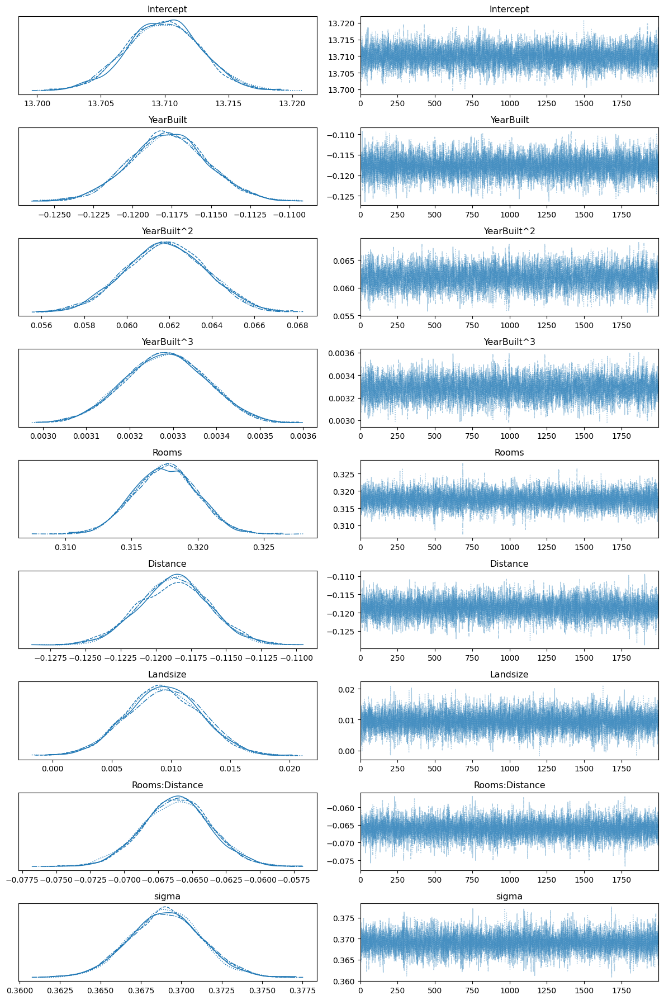

In [61]:
with pm.Model() as model:
    # Priors
    intercept = pm.Normal('Intercept', mu=13.709, sigma=0.0045732)
    year_built = pm.Normal('YearBuilt', mu=-0.1149621, sigma=0.0036046)
    year_built_sq = pm.Normal('YearBuilt^2', mu=0.0603342, sigma=0.0034495)
    year_built_cu = pm.Normal('YearBuilt^3', mu=0.0031557, sigma=0.0001679)
    rooms = pm.Normal('Rooms', mu=0.3170792, sigma=0.0034077)
    distance = pm.Normal('Distance', mu=-0.1185352, sigma=0.0036375)
    landsize = pm.Normal('Landsize', mu=0.0077906, sigma=0.0032234)
    rooms_distance = pm.Normal('Rooms:Distance', mu=-0.0664653, sigma=0.0035962)

    # Model
    mu = (intercept + 
          year_built * df['YearBuilt'] + 
          year_built_sq * df['YearBuilt']**2 + 
          year_built_cu * df['YearBuilt']**3 + 
          rooms * df['Rooms'] + 
          distance * df['Distance'] + 
          landsize * df['Landsize'] + 
          rooms_distance * df['Rooms'] * df['Distance'])

    # Likelihood
    sigma = pm.HalfNormal('sigma', sigma=0.3706)  # Residual standard error
    likelihood = pm.LogNormal('Price', mu=mu, sigma=sigma, observed=df['Price'])

    # MCMC 
    trace = pm.sample(2000, tune=1000, return_inferencedata=True)


print(pm.summary(trace))

pm.plot_trace(trace)
plt.tight_layout()
plt.show()

In [64]:
mcmc_coefficients = {
    'Intercept': 13.710,
    'YearBuilt': -0.118,
    'YearBuilt^2': 0.062,       
    'YearBuilt^3': 0.003,       
    'Rooms': 0.318,
    'Distance': -0.119,
    'Landsize': 0.009,
    'Rooms:Distance': -0.066
}

features = ['YearBuilt', 'YearBuilt^2', 'YearBuilt^3', 'Rooms', 'Distance', 'Landsize', 'Rooms:Distance']
X = df[features].dropna()

X = X.assign(Intercept=1)

y = np.log(df.loc[X.index, 'Price'])  

X = X[['Intercept'] + features]

X = X.to_numpy()
y = y.to_numpy()

beta = np.array([
    mcmc_coefficients['Intercept'],        
    mcmc_coefficients['YearBuilt'],        
    mcmc_coefficients['YearBuilt^2'],      
    mcmc_coefficients['YearBuilt^3'],      
    mcmc_coefficients['Rooms'],            
    mcmc_coefficients['Distance'],         
    mcmc_coefficients['Landsize'],         
    mcmc_coefficients['Rooms:Distance']    
])

def neg_log_likelihood_gradient(beta, X, y):
    mu = X @ beta
    return -X.T @ (y - mu)

def neg_log_likelihood_hessian(beta, X, y):
    return X.T @ X  

tolerance = 1e-6
max_iterations = 100
for iteration in range(max_iterations):
    grad = neg_log_likelihood_gradient(beta, X, y)
    hess = neg_log_likelihood_hessian(beta, X, y)
    
    delta = np.linalg.solve(hess, -grad)
    beta += delta  
    
    if np.linalg.norm(delta) < tolerance:
        print(f"Converged after {iteration + 1} iterations.")
        break
else:
    print("Newton's method did not converge within the maximum number of iterations.")

print("Final Beta Coefficients (from Newton's method):")
print(beta)

Converged after 2 iterations.
Final Beta Coefficients (from Newton's method):
[ 1.37455376e+01  2.09402202e+01 -4.78610259e+01  2.68485354e+01
  4.32704322e-01  8.74910093e-02  3.13982284e-02 -2.74984832e-01]
